In [1]:
import numpy as np 
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score
from sklearn import datasets 
import csv 
import seaborn as sns
import matplotlib.pyplot as plt 
import pandas as pd 
import ahpy 
from sklearn.preprocessing import OneHotEncoder 
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import mean_squared_error 
from sklearn.cluster import KMeans 
from catboost import CatBoostClassifier
from catboost import CatBoostRegressor
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score
import ipywidgets
from scipy import stats 
import xgboost as xgb
%matplotlib inline

# Data Analysis

In [2]:
df = pd.read_csv("C:\\Users\\Uncle Namo\\Desktop\\Python\\tennis_ace_starting\\tennis_ace_starting\\tennis_stats.csv")

In [3]:
df.head

<bound method NDFrame.head of                      Player  Year  FirstServe  FirstServePointsWon  \
0               Pedro Sousa  2016        0.88                 0.50   
1           Roman Safiullin  2017        0.84                 0.62   
2               Pedro Sousa  2017        0.83                 0.60   
3       Rogerio Dutra Silva  2010        0.83                 0.64   
4      Daniel Gimeno-Traver  2017        0.81                 0.54   
...                     ...   ...         ...                  ...   
1716             Yann Marti  2010        0.41                 0.66   
1717          Mikhail Elgin  2012        0.41                 0.60   
1718  Alexander Kudryavtsev  2012        0.40                 0.64   
1719           Ivan Nedelko  2011        0.37                 0.30   
1720       Alexander Zverev  2013        0.36                 0.50   

      FirstServeReturnPointsWon  SecondServePointsWon  \
0                          0.38                  0.50   
1              

In [4]:
df

,Player,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
0,Pedro Sousa,2016,0.88,0.50,0.38,0.50,0.39,0,0.14,7,...,0.11,0.38,8,0.50,0.43,0.50,1,2,39820,119
1,Roman Safiullin,2017,0.84,0.62,0.26,0.33,0.07,7,0.00,7,...,0.00,0.20,9,0.67,0.41,0.57,0,1,17334,381
2,Pedro Sousa,2017,0.83,0.60,0.28,0.53,0.44,2,0.38,10,...,0.16,0.34,17,0.65,0.45,0.59,4,1,109827,119
3,Rogerio Dutra Silva,2010,0.83,0.64,0.34,0.59,0.33,2,0.33,5,...,0.14,0.34,15,0.80,0.49,0.63,0,0,9761,125
4,Daniel Gimeno-Traver,2017,0.81,0.54,0.00,0.33,0.33,1,0.00,2,...,0.00,0.20,2,0.50,0.35,0.50,0,1,32879,272
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716,Yann Marti,2010,0.41,0.66,0.23,0.45,0.50,1,0.75,8,...,0.23,0.36,12,0.67,0.45,0.53,0,1,9117,1062
1717,Mikhail Elgin,2012,0.41,0.60,0.30,0.36,0.60,3,0.60,13,...,0.33,0.43,10,0.40,0.45,0.46,16,20,89755,831
1718,Alexander Kudryavtsev,2012,0.40,0.64,0.21,0.42,0.42,4,0.25,13,...,0.07,0.29,14,0.57,0.40,0.51,0,1,44566,628
1719,Ivan Nedelko,2011,0.37,0.30,0.15,0.24,0.41,1,0.00,5,...,0.00,0.26,6,0.17,0.26,0.26,0,1,17527,264


### Descriptive Analysis 

In [5]:
df.mean()

C:\Users\Uncle Namo\AppData\Local\Temp\ipykernel_16416\3698961737.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df.mean()


Year                            2013.646717
FirstServe                         0.598053
FirstServePointsWon                0.680738
FirstServeReturnPointsWon          0.261673
SecondServePointsWon               0.479733
SecondServeReturnPointsWon         0.466432
Aces                              97.105171
BreakPointsConverted               0.369407
BreakPointsFaced                 112.003486
BreakPointsOpportunities         102.918071
BreakPointsSaved                   0.565386
DoubleFaults                      49.112144
ReturnGamesPlayed                198.307960
ReturnGamesWon                     0.173823
ReturnPointsWon                    0.342208
ServiceGamesPlayed               197.650203
ServiceGamesWon                    0.715590
TotalPointsWon                     0.473155
TotalServicePointsWon              0.599245
Wins                               7.876816
Losses                             9.278908
Winnings                      234492.757118
Ranking                         

In [6]:
df.median()

C:\Users\Uncle Namo\AppData\Local\Temp\ipykernel_16416\530051474.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df.median()


Year                            2014.00
FirstServe                         0.60
FirstServePointsWon                0.69
FirstServeReturnPointsWon          0.27
SecondServePointsWon               0.49
SecondServeReturnPointsWon         0.48
Aces                              34.00
BreakPointsConverted               0.38
BreakPointsFaced                  55.00
BreakPointsOpportunities          41.00
BreakPointsSaved                   0.59
DoubleFaults                      23.00
ReturnGamesPlayed                 86.00
ReturnGamesWon                     0.18
ReturnPointsWon                    0.35
ServiceGamesPlayed                86.00
ServiceGamesWon                    0.75
TotalPointsWon                     0.48
TotalServicePointsWon              0.61
Wins                               3.00
Losses                             5.00
Winnings                      125212.00
Ranking                          166.00
dtype: float64

In [7]:
df.mode()

,Player,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
0,Andreas Seppi,2017.0,0.59,0.72,0.28,0.5,0.5,1.0,0.0,7.0,...,0.19,0.35,9.0,0.78,0.49,0.62,0.0,1.0,6171.0,1051.0
1,Andrey Kuznetsov,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,67115.0,NaN
2,Benjamin Becker,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,123931.0,NaN
3,Daniel Brands,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,154062.0,NaN
4,Daniel Gimeno-Traver,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5,Denis Istomin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6,Donald Young,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
7,Dudi Sela,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
8,Evgeny Donskoy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
9,Federico Delbonis,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [8]:
df.std()

C:\Users\Uncle Namo\AppData\Local\Temp\ipykernel_16416\3390915376.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df.std()


Year                               2.488018
FirstServe                         0.054533
FirstServePointsWon                0.070422
FirstServeReturnPointsWon          0.056639
SecondServePointsWon               0.066902
SecondServeReturnPointsWon         0.068447
Aces                             137.966077
BreakPointsConverted               0.162987
BreakPointsFaced                 119.247651
BreakPointsOpportunities         122.761670
BreakPointsSaved                   0.119426
DoubleFaults                      56.630264
ReturnGamesPlayed                221.296070
ReturnGamesWon                     0.080880
ReturnPointsWon                    0.049369
ServiceGamesPlayed               221.208703
ServiceGamesWon                    0.123287
TotalPointsWon                     0.037139
TotalServicePointsWon              0.057718
Wins                              10.183716
Losses                             8.996450
Winnings                      253053.693697
Ranking                         

### Exploratory Data Analysis 

In [9]:
df.describe()

,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,BreakPointsOpportunities,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
count,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,...,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1721.000000,1.721000e+03,1721.000000
mean,2013.646717,0.598053,0.680738,0.261673,0.479733,0.466432,97.105171,0.369407,112.003486,102.918071,...,0.173823,0.342208,197.650203,0.715590,0.473155,0.599245,7.876816,9.278908,2.344928e+05,269.610691
std,2.488018,0.054533,0.070422,0.056639,0.066902,0.068447,137.966077,0.162987,119.247651,122.761670,...,0.080880,0.049369,221.208703,0.123287,0.037139,0.057718,10.183716,8.996450,2.530537e+05,277.341947
min,2009.000000,0.360000,0.270000,0.000000,0.060000,0.000000,0.000000,0.000000,1.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.220000,0.250000,0.000000,0.000000,1.080000e+02,3.000000
25%,2012.000000,0.570000,0.650000,0.240000,0.460000,0.440000,7.000000,0.320000,15.000000,9.000000,...,0.130000,0.320000,22.000000,0.670000,0.460000,0.570000,0.000000,2.000000,4.931100e+04,83.000000
50%,2014.000000,0.600000,0.690000,0.270000,0.490000,0.480000,34.000000,0.380000,55.000000,41.000000,...,0.180000,0.350000,86.000000,0.750000,0.480000,0.610000,3.000000,5.000000,1.252120e+05,166.000000
75%,2016.000000,0.630000,0.720000,0.290000,0.520000,0.500000,140.000000,0.430000,201.000000,172.000000,...,0.220000,0.370000,348.000000,0.790000,0.500000,0.630000,13.000000,17.000000,3.500750e+05,333.000000
max,2017.000000,0.880000,0.890000,0.480000,0.920000,0.750000,1185.000000,1.000000,507.000000,573.000000,...,0.560000,0.510000,916.000000,1.000000,0.820000,0.820000,48.000000,36.000000,1.074562e+06,1443.000000


In [10]:
from ydata_profiling import ProfileReport 

In [11]:
ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

####  Correlation Heat Map

In [12]:
correlation_matrix = df.corr()

In [13]:
correlation_matrix

,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,BreakPointsOpportunities,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
Year,1.000000,0.051406,-0.016728,-0.106784,0.005300,-0.039087,-0.108367,-0.072404,-0.101735,-0.114806,...,-0.073256,-0.078229,-0.108477,-0.008930,-0.041790,-0.005544,-0.108235,-0.077181,0.043908,-0.040483
FirstServe,0.051406,1.000000,-0.070659,0.025488,0.101417,-0.001924,0.048149,-0.018877,0.057709,0.062345,...,-0.010676,0.004189,0.071920,0.137473,0.148349,0.180996,0.064832,0.053736,0.057882,-0.068759
FirstServePointsWon,-0.016728,-0.070659,1.000000,0.021729,0.320765,-0.004724,0.460323,-0.041538,0.301925,0.324853,...,-0.010193,-0.002793,0.376460,0.817829,0.648753,0.860033,0.356702,0.330581,0.361121,-0.150004
FirstServeReturnPointsWon,-0.106784,0.025488,0.021729,1.000000,0.072707,0.301265,0.140165,0.324057,0.295724,0.313338,...,0.757435,0.834267,0.261206,0.091319,0.496682,0.052335,0.256029,0.243278,0.240808,-0.178664
SecondServePointsWon,0.005300,0.101417,0.320765,0.072707,1.000000,0.103584,0.266269,0.052755,0.258691,0.277782,...,0.096622,0.095585,0.296809,0.650764,0.622673,0.713076,0.268979,0.250918,0.281215,-0.181013
SecondServeReturnPointsWon,-0.039087,-0.001924,-0.004724,0.301265,0.103584,1.000000,0.095494,0.264413,0.234212,0.249583,...,0.603755,0.727338,0.209521,0.096553,0.408975,0.055004,0.193093,0.185217,0.199401,-0.159592
Aces,-0.108367,0.048149,0.460323,0.140165,0.266269,0.095494,1.000000,0.037188,0.757405,0.784934,...,0.139987,0.138023,0.866138,0.440922,0.428679,0.472101,0.825301,0.768628,0.798404,-0.277811
BreakPointsConverted,-0.072404,-0.018877,-0.041538,0.324057,0.052755,0.264413,0.037188,1.000000,0.096368,0.086502,...,0.561759,0.387170,0.083182,-0.025670,0.255050,-0.007254,0.076989,0.062297,0.075022,-0.051005
BreakPointsFaced,-0.101735,0.057709,0.301925,0.295724,0.258691,0.234212,0.757405,0.096368,1.000000,0.973352,...,0.335205,0.331043,0.971296,0.354012,0.463110,0.354005,0.883470,0.943309,0.876036,-0.322082
BreakPointsOpportunities,-0.114806,0.062345,0.324853,0.313338,0.277782,0.249583,0.784934,0.086502,0.973352,1.000000,...,0.358483,0.352783,0.978278,0.372271,0.491198,0.380716,0.923453,0.909295,0.900444,-0.334548


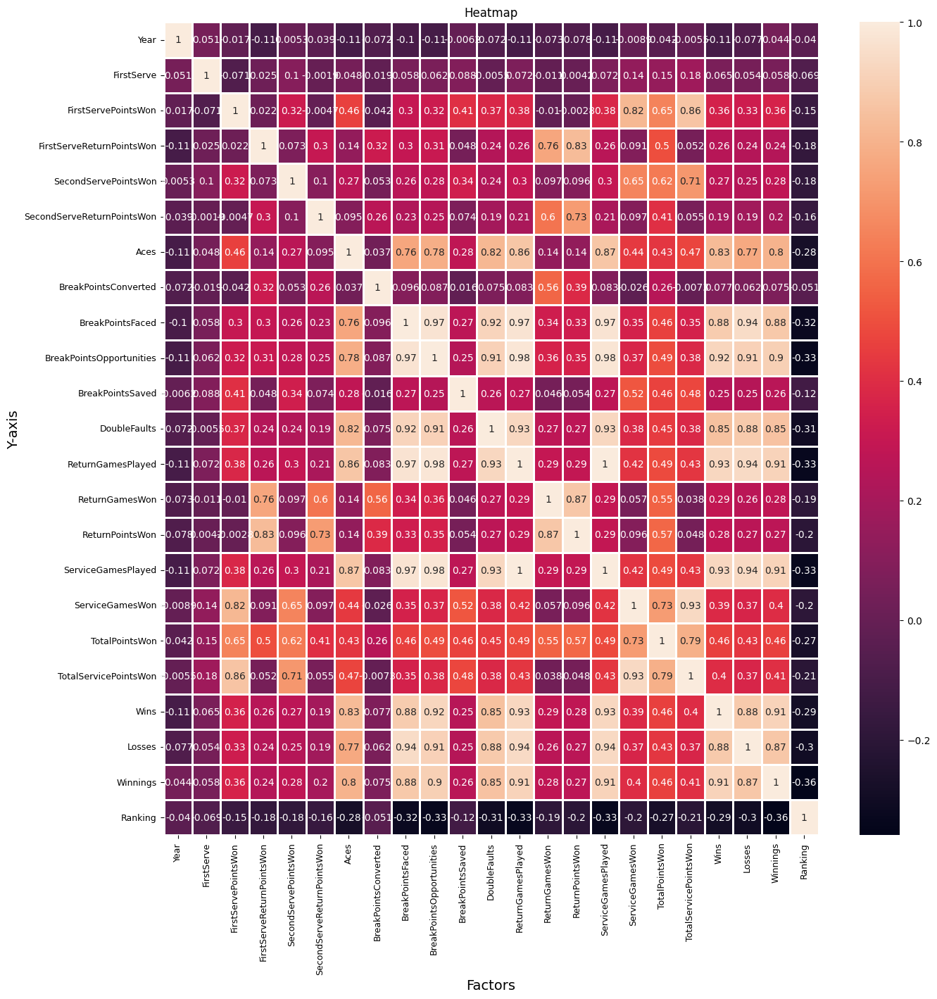

In [14]:
fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(correlation_matrix.iloc[:], annot=True, linewidths=1, ax=ax)


# Modify the font size of the tick labels
ax.tick_params(axis='both', labelsize=9)

# Modify the font size of the x-axis and y-axis labels
ax.set_xlabel('Factors', fontsize=14)
ax.set_ylabel('Y-axis', fontsize=14)

# Modify the font size of the colorbar label
cbar = ax.collections[0].colorbar
cbar.ax.tick_params(labelsize=10)

# Add other plot customization if needed
ax.set_title('Heatmap', fontsize=12)

plt.show()

# PreProcessing

In [58]:
selected_columns = ['Year'
,'FirstServePointsWon'
,'SecondServePointsWon'
,'BreakPointsFaced'
,'BreakPointsOpportunities'
,'BreakPointsSaved'
,'ServiceGamesPlayed'	
,'ServiceGamesWon'
,'TotalPointsWon'	
,'TotalServicePointsWon'
,'DoubleFaults'
,'ReturnGamesPlayed'
,'Wins'	
,'Losses'	
,'Winnings'
,'ReturnGamesWon'
,'ReturnPointsWon'
,'Ranking','Aces']

In [59]:
df

,Player,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
0,Pedro Sousa,2016,0.88,0.50,0.38,0.50,0.39,0,0.14,7,...,0.11,0.38,8,0.50,0.43,0.50,1,2,39820,119
1,Roman Safiullin,2017,0.84,0.62,0.26,0.33,0.07,7,0.00,7,...,0.00,0.20,9,0.67,0.41,0.57,0,1,17334,381
2,Pedro Sousa,2017,0.83,0.60,0.28,0.53,0.44,2,0.38,10,...,0.16,0.34,17,0.65,0.45,0.59,4,1,109827,119
3,Rogerio Dutra Silva,2010,0.83,0.64,0.34,0.59,0.33,2,0.33,5,...,0.14,0.34,15,0.80,0.49,0.63,0,0,9761,125
4,Daniel Gimeno-Traver,2017,0.81,0.54,0.00,0.33,0.33,1,0.00,2,...,0.00,0.20,2,0.50,0.35,0.50,0,1,32879,272
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716,Yann Marti,2010,0.41,0.66,0.23,0.45,0.50,1,0.75,8,...,0.23,0.36,12,0.67,0.45,0.53,0,1,9117,1062
1717,Mikhail Elgin,2012,0.41,0.60,0.30,0.36,0.60,3,0.60,13,...,0.33,0.43,10,0.40,0.45,0.46,16,20,89755,831
1718,Alexander Kudryavtsev,2012,0.40,0.64,0.21,0.42,0.42,4,0.25,13,...,0.07,0.29,14,0.57,0.40,0.51,0,1,44566,628
1719,Ivan Nedelko,2011,0.37,0.30,0.15,0.24,0.41,1,0.00,5,...,0.00,0.26,6,0.17,0.26,0.26,0,1,17527,264


In [60]:
df.dropna()

,Player,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
0,Pedro Sousa,2016,0.88,0.50,0.38,0.50,0.39,0,0.14,7,...,0.11,0.38,8,0.50,0.43,0.50,1,2,39820,119
1,Roman Safiullin,2017,0.84,0.62,0.26,0.33,0.07,7,0.00,7,...,0.00,0.20,9,0.67,0.41,0.57,0,1,17334,381
2,Pedro Sousa,2017,0.83,0.60,0.28,0.53,0.44,2,0.38,10,...,0.16,0.34,17,0.65,0.45,0.59,4,1,109827,119
3,Rogerio Dutra Silva,2010,0.83,0.64,0.34,0.59,0.33,2,0.33,5,...,0.14,0.34,15,0.80,0.49,0.63,0,0,9761,125
4,Daniel Gimeno-Traver,2017,0.81,0.54,0.00,0.33,0.33,1,0.00,2,...,0.00,0.20,2,0.50,0.35,0.50,0,1,32879,272
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716,Yann Marti,2010,0.41,0.66,0.23,0.45,0.50,1,0.75,8,...,0.23,0.36,12,0.67,0.45,0.53,0,1,9117,1062
1717,Mikhail Elgin,2012,0.41,0.60,0.30,0.36,0.60,3,0.60,13,...,0.33,0.43,10,0.40,0.45,0.46,16,20,89755,831
1718,Alexander Kudryavtsev,2012,0.40,0.64,0.21,0.42,0.42,4,0.25,13,...,0.07,0.29,14,0.57,0.40,0.51,0,1,44566,628
1719,Ivan Nedelko,2011,0.37,0.30,0.15,0.24,0.41,1,0.00,5,...,0.00,0.26,6,0.17,0.26,0.26,0,1,17527,264


### Z-Score All

In [61]:
df_new = df[selected_columns]

In [62]:
# Calculate the Z-scores for each column in the DataFrame
z_scores = np.abs(stats.zscore(df_new))

# Set a threshold and filter outliers
threshold = 3
filtered_df = df[(z_scores < threshold).all(axis=1)]

In [63]:
# Display the results
print("Original DataFrame:")
print(df_new)

print("\nFiltered DataFrame:")
print(filtered_df)

Original DataFrame:
      Year  FirstServePointsWon  SecondServePointsWon  BreakPointsFaced  \
0     2016                 0.50                  0.50                 7   
1     2017                 0.62                  0.33                 7   
2     2017                 0.60                  0.53                10   
3     2010                 0.64                  0.59                 5   
4     2017                 0.54                  0.33                 2   
...    ...                  ...                   ...               ...   
1716  2010                 0.66                  0.45                 8   
1717  2012                 0.60                  0.36                13   
1718  2012                 0.64                  0.42                13   
1719  2011                 0.30                  0.24                 5   
1720  2013                 0.50                  0.24                 8   

      BreakPointsOpportunities  BreakPointsSaved  ServiceGamesPlayed  \
0      

### Z-Score of Aces

### Interquartile Range DPW

In [64]:
Q1 = df.Aces.quantile(0.25)
Q3 = df.Aces.quantile(0.75)

In [65]:
IQR = Q3 - Q1

In [66]:
Q3

140.0

In [67]:
Q1

7.0

In [68]:
lower_limit = Q1- 1.5 *IQR
upper_limit = Q3 + 1.5 * IQR
lower_limit, upper_limit

(-192.5, 339.5)

In [69]:
outliers = df[(df.Aces<lower_limit) | (df.Aces>upper_limit)]

In [70]:
df_no_outliers = df[(df.Aces>lower_limit) & (df.Aces<upper_limit)]

In [71]:
outliers

,Player,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
49,John Isner,2011,0.69,0.77,0.24,0.55,0.42,811,0.34,217,...,0.13,0.31,784,0.91,0.51,0.70,36,21,989679,9
53,John Isner,2010,0.69,0.76,0.22,0.55,0.42,1048,0.33,296,...,0.11,0.29,916,0.90,0.50,0.69,38,24,904620,9
85,Denis Istomin,2014,0.68,0.72,0.27,0.51,0.48,354,0.40,325,...,0.19,0.35,646,0.81,0.50,0.65,28,26,626402,88
101,Bernard Tomic,2013,0.68,0.72,0.23,0.51,0.48,345,0.34,283,...,0.15,0.33,571,0.84,0.49,0.65,25,22,648750,182
107,Ivo Karlovic,2014,0.67,0.84,0.21,0.54,0.40,1185,0.32,209,...,0.09,0.28,803,0.93,0.51,0.74,36,28,869356,76
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1587,Marcos Baghdatis,2010,0.52,0.76,0.31,0.52,0.50,498,0.38,421,...,0.24,0.39,823,0.80,0.51,0.64,43,27,935483,81
1588,Marcos Baghdatis,2011,0.52,0.76,0.29,0.52,0.48,400,0.43,345,...,0.22,0.37,669,0.80,0.50,0.64,28,27,588435,81
1625,Benoit Paire,2012,0.51,0.73,0.33,0.47,0.51,385,0.37,407,...,0.26,0.39,656,0.73,0.50,0.60,26,26,467451,48
1627,Alexandr Dolgopolov,2011,0.51,0.76,0.30,0.51,0.50,559,0.43,411,...,0.24,0.38,805,0.79,0.51,0.63,38,29,1027621,53


In [72]:
outliers.Aces.max()

1185

In [73]:
result_df = df[df['Aces'] == 1185]

In [74]:
result_df

,Player,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
107,Ivo Karlovic,2014,0.67,0.84,0.21,0.54,0.4,1185,0.32,209,...,0.09,0.28,803,0.93,0.51,0.74,36,28,869356,76


In [75]:
result_df.count()

Player                        1
Year                          1
FirstServe                    1
FirstServePointsWon           1
FirstServeReturnPointsWon     1
SecondServePointsWon          1
SecondServeReturnPointsWon    1
Aces                          1
BreakPointsConverted          1
BreakPointsFaced              1
BreakPointsOpportunities      1
BreakPointsSaved              1
DoubleFaults                  1
ReturnGamesPlayed             1
ReturnGamesWon                1
ReturnPointsWon               1
ServiceGamesPlayed            1
ServiceGamesWon               1
TotalPointsWon                1
TotalServicePointsWon         1
Wins                          1
Losses                        1
Winnings                      1
Ranking                       1
dtype: int64

In [76]:
outliers.Aces.min()

343

In [77]:
df_no_outliers

,Player,Year,FirstServe,FirstServePointsWon,FirstServeReturnPointsWon,SecondServePointsWon,SecondServeReturnPointsWon,Aces,BreakPointsConverted,BreakPointsFaced,...,ReturnGamesWon,ReturnPointsWon,ServiceGamesPlayed,ServiceGamesWon,TotalPointsWon,TotalServicePointsWon,Wins,Losses,Winnings,Ranking
0,Pedro Sousa,2016,0.88,0.50,0.38,0.50,0.39,0,0.14,7,...,0.11,0.38,8,0.50,0.43,0.50,1,2,39820,119
1,Roman Safiullin,2017,0.84,0.62,0.26,0.33,0.07,7,0.00,7,...,0.00,0.20,9,0.67,0.41,0.57,0,1,17334,381
2,Pedro Sousa,2017,0.83,0.60,0.28,0.53,0.44,2,0.38,10,...,0.16,0.34,17,0.65,0.45,0.59,4,1,109827,119
3,Rogerio Dutra Silva,2010,0.83,0.64,0.34,0.59,0.33,2,0.33,5,...,0.14,0.34,15,0.80,0.49,0.63,0,0,9761,125
4,Daniel Gimeno-Traver,2017,0.81,0.54,0.00,0.33,0.33,1,0.00,2,...,0.00,0.20,2,0.50,0.35,0.50,0,1,32879,272
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1716,Yann Marti,2010,0.41,0.66,0.23,0.45,0.50,1,0.75,8,...,0.23,0.36,12,0.67,0.45,0.53,0,1,9117,1062
1717,Mikhail Elgin,2012,0.41,0.60,0.30,0.36,0.60,3,0.60,13,...,0.33,0.43,10,0.40,0.45,0.46,16,20,89755,831
1718,Alexander Kudryavtsev,2012,0.40,0.64,0.21,0.42,0.42,4,0.25,13,...,0.07,0.29,14,0.57,0.40,0.51,0,1,44566,628
1719,Ivan Nedelko,2011,0.37,0.30,0.15,0.24,0.41,1,0.00,5,...,0.00,0.26,6,0.17,0.26,0.26,0,1,17527,264


# Catboost Multiple Regression Model 

In [124]:
selected_columns_boost = ['Year'
,'FirstServePointsWon'
,'SecondServePointsWon'
,'BreakPointsFaced'
,'BreakPointsOpportunities'
,'BreakPointsSaved'
,'ServiceGamesPlayed'	
,'ServiceGamesWon'
,'TotalPointsWon'	
,'TotalServicePointsWon'
,'DoubleFaults'
,'ReturnGamesPlayed'
,'Wins'	
,'Losses'	
,'Winnings'
,'ReturnGamesWon'
,'ReturnPointsWon'
,'Ranking'
]

In [125]:
X = filtered_df[selected_columns_boost]
y = filtered_df['Aces']

In [126]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [127]:
model = CatBoostRegressor(iterations=10000,  # Number of boosting iterations (trees)
                             learning_rate=0.1,  # Step size for gradient descent
                             depth=6,  # Depth of the trees
                             loss_function='RMSE',  # Loss function for regression tasks
                             random_seed=42,  # Random seed for reproducibility
                             logging_level='Silent')  # Set 'Verbose' to see training progress


In [128]:
model.fit(X_train,y_train)

In [129]:
y_pred = model.predict(X_test)

In [130]:
mse = mean_squared_error(y_test,y_pred)
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 450.3295778305361


In [131]:
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MSE: {mse:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"R-squared: {r2:.2f}")

MSE: 450.33
RMSE: 21.22
R-squared: 0.95


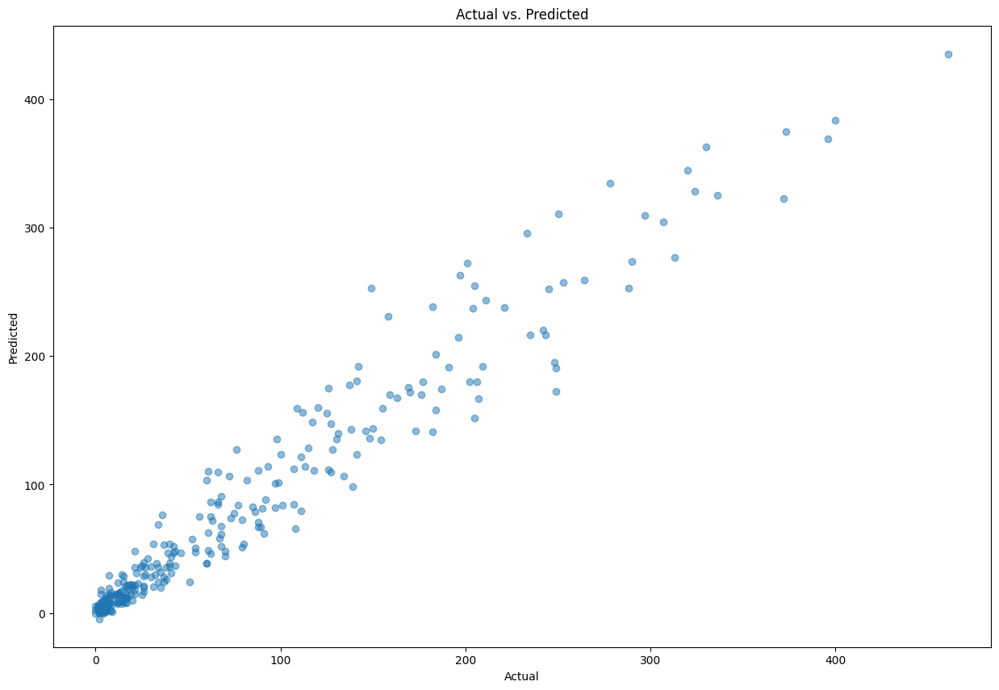

In [132]:
plt.figure(figsize =(15,10))
plt.scatter(y_test,y_pred, alpha = 0.5)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Actual vs. Predicted")

plt.show()

In [133]:
selected_columns_boost = ['FirstServePointsWon'
,'SecondServePointsWon'
,'BreakPointsFaced'
,'BreakPointsOpportunities'
,'BreakPointsSaved'
,'ServiceGamesPlayed'	
,'ServiceGamesWon'
,'TotalPointsWon'
,'DoubleFaults'
,'ReturnGamesPlayed'
,'TotalServicePointsWon'	
,'Wins'	
,'Losses'	
,'Winnings'	
,'Ranking']

In [134]:
X = df_no_outliers[selected_columns_boost]
y = df_no_outliers['Aces']

In [135]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [136]:
model = CatBoostRegressor(iterations=10000,  # Number of boosting iterations (trees)
                             learning_rate=0.1,  # Step size for gradient descent
                             depth=6,  # Depth of the trees
                             loss_function='RMSE',  # Loss function for regression tasks
                             random_seed=42,  # Random seed for reproducibility
                             logging_level='Silent')  # Set 'Verbose' to see training progress


In [137]:
model.fit(X_train,y_train)

In [138]:
y_pred = model.predict(X_test)

In [139]:
mse = mean_squared_error(y_test,y_pred)
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 484.84999520253734


In [148]:
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
r2 = r2_score(y_test, y_pred)

print(f"MSE: {mse:.2f}")
print(f"RMSE: {rmse:.2f}")
print(f"R-squared: {r2:.2f}")

MSE: 582.58
RMSE: 24.14
R-squared: 0.93


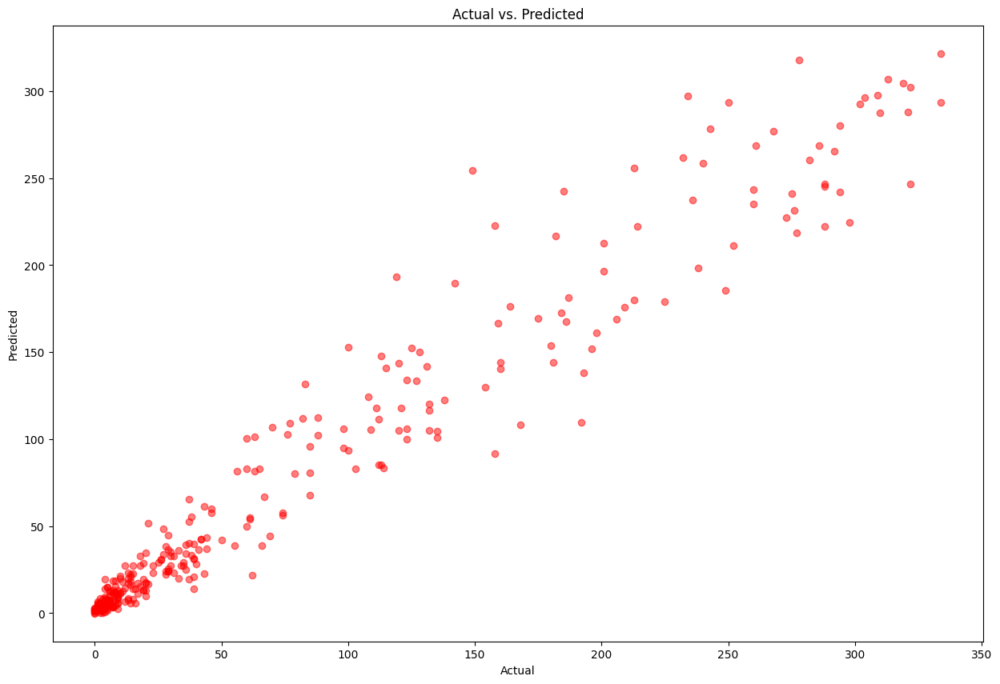

In [140]:
plt.figure(figsize =(15,10))
plt.scatter(y_test,y_pred, alpha = 0.5, color = 'red')
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Actual vs. Predicted")

plt.show()

# XGB Regression Model 

In [141]:
X = filtered_df[selected_columns_boost]
y = filtered_df['Aces']

In [142]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)


In [143]:
xgb_model = xgb.XGBRegressor(
    learning_rate=0.1,
    n_estimators=1000,
    max_depth=4,
    random_state=42,
    obj = "reg:squared_error"
)

In [144]:
xgb_model.fit(X_train,y_train)

[22:28:49] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0fdc6d574b9c0d168-1\xgboost\xgboost-ci-windows\src\learner.cc:767: 
Parameters: { "obj" } are not used.



XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=None, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=None, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.1, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=4, max_leaves=None,
             min_child_weight=None, missing=nan, monotone_constraints=None,
             n_estimators=1000, n_jobs=None, num_parallel_tree=None,
             obj='reg:squared_error', predictor=None, ...)

In [145]:
y_pred = xgb_model.predict(X_test)

In [146]:
mse = mean_squared_error(y_test,y_pred)
print(f"Mean Squared Error: {mse}")

Mean Squared Error: 582.5846625931154


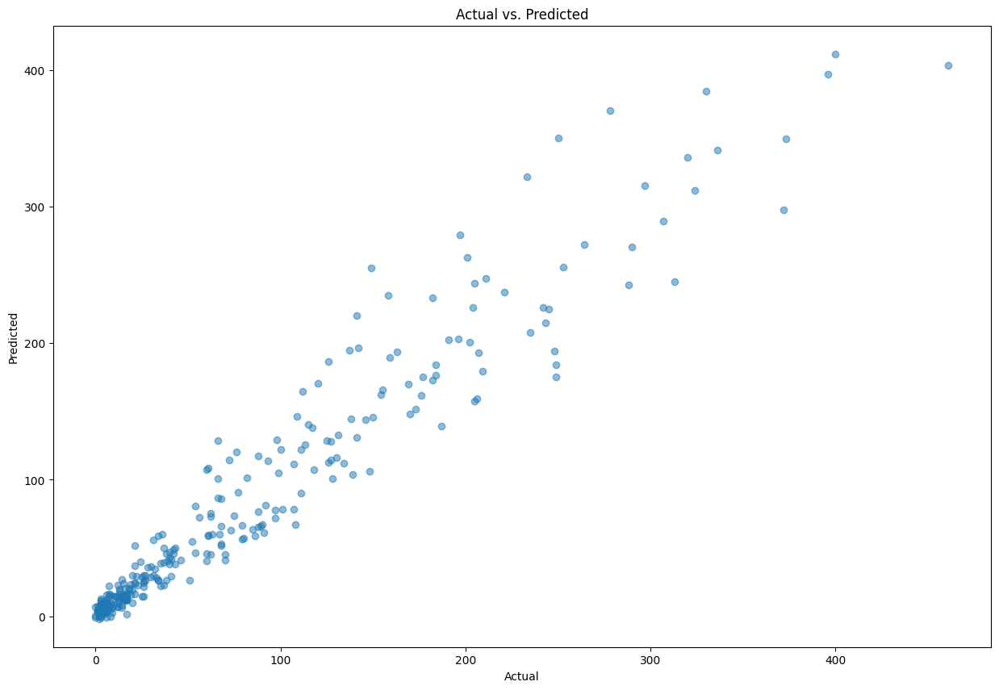

In [147]:
plt.figure(figsize =(15,10))
plt.scatter(y_test,y_pred, alpha = 0.5)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title("Actual vs. Predicted")

plt.show()